# Load dataset

https://tiki.vn/cay-cam-ngot-cua-toi-p74021317.html?itm_campaign=tiki-reco_UNK_DT_UNK_UNK_tiki-listing_UNK_p-category-mpid-listing-v1_202306180600_MD_batched_PID.74021318&itm_medium=CPC&itm_source=tiki-reco&spid=74021318&fbclid=IwAR3CWUHqTQvX6z7RsHwsyveVuQyxz5rQNnSn3u2CfOgYU57tNZfkHeClxfY

In [1]:
!git clone https://github.com/stopwords/vietnamese-stopwords.git

Cloning into 'vietnamese-stopwords'...
remote: Enumerating objects: 95, done.
remote: Counting objects: 100% (14/14), done.
remote: Compressing objects: 100% (10/10), done.
remote: Total 95 (delta 3), reused 0 (delta 0), pack-reused 81
Unpacking objects: 100% (95/95), 40.23 KiB | 1.92 MiB/s, done.


In [2]:
!pip install underthesea

Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 19.2/19.2 MB 82.4 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 993.5/993.5 kB 53.9 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 599.6/599.6 kB 42.9 MB/s eta 0:00:00


In [3]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns

from bs4 import BeautifulSoup
import nltk
import re
import string
from imblearn.over_sampling import SMOTE

from underthesea import word_tokenize, text_normalize, sentiment

In [4]:
df = pd.read_csv('/content/comment_product_data_tiki.csv')
print('Shape dataset:', df.shape)
df.head()

Shape dataset: (12735, 18)


,id,title,content,status,comment_count,thank_count,customer_id,product_id,rating,score,created_at,is_photo,customer_name,purchased_at,delivery_date,review_created_date,agree_vote,disagree_vote
0,NaN,Cực kì hài lòng,"Có những người bước đến, họ lấp đầy hạnh phúc ...",approved,5,369,22051463,74021317,5,0.021633,1633960872,True,Vân Anh,1.631546e+09,2021-09-14 10:42:24,2021-10-11 21:01:12,[],[]
1,NaN,Cực kì hài lòng,"Thấy nhiều bạn chê tiki gói hàng quá, may sao ...",approved,0,12,27791831,74021317,5,0.017529,1657206097,True,Phan Thảo Yến Nhím,1.657110e+09,2022-07-07 10:43:42,2022-07-07 22:01:37,[],[]
2,NaN,Cực kì hài lòng,"Bìa cực xinh, tiki giao hàng nhanh, sách không...",approved,3,25,17748750,74021317,5,0.015487,1640442831,True,Trần Thị Trang,1.640014e+09,2021-12-21 09:27:12,2021-12-25 21:33:51,[],[]
3,NaN,Cực kì hài lòng,"Nội dung của sách thì không phải bàn đến rồi, ...",approved,0,16,10149686,74021317,5,0.008848,1632568671,True,Khánh Ly,1.632483e+09,2021-09-25 13:26:08,2021-09-25 18:17:51,[],[]
4,NaN,Cực kì hài lòng,Một cuốn sách rất đáng đọc về tình yêu thương ...,approved,2,1,28545286,74021317,5,0.041920,1670438913,True,Phương Linh,1.670236e+09,2022-12-06 15:09:24,2022-12-08 01:48:33,[],[]


# Exploratory Data Analysis

In [ ]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 12735 entries, 0 to 12734
Data columns (total 18 columns):
 #   Column               Non-Null Count  Dtype  
---  ------               --------------  -----  
 0   id                   0 non-null      float64
 1   title                12735 non-null  object 
 2   content              4202 non-null   object 
 3   status               12735 non-null  object 
 4   comment_count        12735 non-null  int64  
 5   thank_count          12735 non-null  int64  
 6   customer_id          12735 non-null  int64  
 7   product_id           12735 non-null  int64  
 8   rating               12735 non-null  int64  
 9   score                12726 non-null  float64
 10  created_at           12735 non-null  int64  
 11  is_photo             12735 non-null  bool   
 12  customer_name        12713 non-null  object 
 13  purchased_at         12726 non-null  float64
 14  delivery_date        12513 non-null  object 
 15  review_created_date  12513 non-null 

In [ ]:
df.isnull().sum()

id                     12735
title                      0
content                 8533
status                     0
comment_count              0
thank_count                0
customer_id                0
product_id                 0
rating                     0
score                      9
created_at                 0
is_photo                   0
customer_name             22
purchased_at               9
delivery_date            222
review_created_date      222
agree_vote                 0
disagree_vote              0
dtype: int64

In [ ]:
df.describe()

,id,comment_count,thank_count,customer_id,product_id,rating,score,created_at,purchased_at
count,0.0,12735.000000,12735.000000,1.273500e+04,12735.0,12735.000000,12726.000000,1.273500e+04,1.272600e+04
mean,NaN,0.003926,0.111425,1.323267e+07,74021317.0,4.889203,22.592269,1.642465e+09,1.640692e+09
std,NaN,0.102507,4.831241,8.543151e+06,0.0,0.425608,12.068083,1.765750e+07,1.745075e+07
min,NaN,0.000000,0.000000,7.420000e+02,74021317.0,1.000000,0.000000,1.608391e+09,1.608203e+09
25%,NaN,0.000000,0.000000,6.403038e+06,74021317.0,5.000000,27.777778,1.629618e+09,1.628314e+09
50%,NaN,0.000000,0.000000,1.283149e+07,74021317.0,5.000000,27.777778,1.639967e+09,1.638844e+09
75%,NaN,0.000000,0.000000,2.059777e+07,74021317.0,5.000000,27.777778,1.652104e+09,1.650333e+09
max,NaN,5.000000,369.000000,2.917407e+07,74021317.0,5.000000,55.555556,1.687186e+09,1.687102e+09


In [ ]:
print('Number of duplicated rows: ', len(df[df.duplicated()]))
df[df.duplicated()]

Number of duplicated rows:  5


,id,title,content,status,comment_count,thank_count,customer_id,product_id,rating,score,created_at,is_photo,customer_name,purchased_at,delivery_date,review_created_date,agree_vote,disagree_vote
5,NaN,Cực kì hài lòng,"Có những người bước đến, họ lấp đầy hạnh phúc ...",approved,5,369,22051463,74021317,5,0.021633,1633960872,True,Vân Anh,1.631546e+09,2021-09-14 10:42:24,2021-10-11 21:01:12,[],[]
6,NaN,Cực kì hài lòng,"Thấy nhiều bạn chê tiki gói hàng quá, may sao ...",approved,0,12,27791831,74021317,5,0.017529,1657206097,True,Phan Thảo Yến Nhím,1.657110e+09,2022-07-07 10:43:42,2022-07-07 22:01:37,[],[]
7,NaN,Cực kì hài lòng,"Bìa cực xinh, tiki giao hàng nhanh, sách không...",approved,3,25,17748750,74021317,5,0.015487,1640442831,True,Trần Thị Trang,1.640014e+09,2021-12-21 09:27:12,2021-12-25 21:33:51,[],[]
8,NaN,Cực kì hài lòng,"Nội dung của sách thì không phải bàn đến rồi, ...",approved,0,16,10149686,74021317,5,0.008848,1632568671,True,Khánh Ly,1.632483e+09,2021-09-25 13:26:08,2021-09-25 18:17:51,[],[]
9,NaN,Cực kì hài lòng,Một cuốn sách rất đáng đọc về tình yêu thương ...,approved,2,1,28545286,74021317,5,0.041920,1670438913,True,Phương Linh,1.670236e+09,2022-12-06 15:09:24,2022-12-08 01:48:33,[],[]


In [5]:
df.drop_duplicates(inplace = True)

In [ ]:
!pip3 install pandas-profiling

In [ ]:
from pandas_profiling import ProfileReport
profile = ProfileReport(
    df.drop('content', axis = 1), title="Pandas Profiling Report dataset"
)
profile.to_notebook_iframe()

Summarize dataset:   0%|          | 0/5 [00:00<?, ?it/s]

Generate report structure:   0%|          | 0/1 [00:00<?, ?it/s]

Render HTML:   0%|          | 0/1 [00:00<?, ?it/s]

Drop columns:
*  id, product_id, customer_id, customer_name, created_at, purchased_at cause its not necessary

*  status - constant value

*  agree_vote, disagree_vote missing to much

Title - ordinal categorical feature, high cardinality, imbalance -> grouping category less than 20 values

comment_count - numeric feature, right-skewed zeros value (99.8%)

thank_counts - numeric feature, right-skewed zeros value(98.9%)

score - numeric feature, missing 9 values -> drop cause its minority values,

delivery_date, review_created_date

Target: rating - imbalance 91.5%, multi-class



## Preprocessing data

### Numeric and categorical features

In [6]:
def preprocessing_data(df):
    df.drop(['id', 'product_id', 'customer_id', 'customer_name', 'created_at', 'purchased_at',
             'status','agree_vote','disagree_vote'], axis = 1, inplace = True)

    # title, reduce high cardinality
    threshold = 0.001
    value__title = df['title'].value_counts(normalize = True)
    filtered_values = value__title[value__title < threshold].index.tolist()
    df['title'] = df['title'].replace(filtered_values, 'Others')

    df.dropna(subset = ['review_created_date','delivery_date'], axis = 0, inplace = True)

    df['review_created_date'] = pd.to_datetime(df['review_created_date'], format = '%Y-%m-%d %H:%M:%S')
    df['delivery_date'] = pd.to_datetime(df['delivery_date'], format = '%Y-%m-%d %H:%M:%S')
    df['response_day'] = df['review_created_date'] - df['delivery_date']
    df['response_day'] = df['response_day'].dt.days

    df['review_created_year'] = df['review_created_date'].dt.year
    df['review_created_month'] = df['review_created_date'].dt.month
    df['review_created_day'] = df['review_created_date'].dt.day
    df['review_created_hour'] = df['review_created_date'].dt.hour
    df['review_created_minute'] = df['review_created_date'].dt.minute
    df['review_created_second'] = df['review_created_date'].dt.second

    df['delivery_year'] = df['delivery_date'].dt.year
    df['delivery_month'] = df['delivery_date'].dt.month
    df['delivery_day'] = df['delivery_date'].dt.day
    df['delivery_hour'] = df['delivery_date'].dt.hour
    df['delivery_minute'] = df['delivery_date'].dt.minute
    df['delivery_second'] = df['delivery_date'].dt.second

    df.drop(['delivery_date','review_created_date'], axis = 1, inplace = True)

    df['content'].fillna(value = '', inplace = True)

    return df

In [7]:
preprocess_df = preprocessing_data(df.copy())
preprocess_df

,title,content,comment_count,thank_count,rating,score,is_photo,response_day,review_created_year,review_created_month,review_created_day,review_created_hour,review_created_minute,review_created_second,delivery_year,delivery_month,delivery_day,delivery_hour,delivery_minute,delivery_second
0,Cực kì hài lòng,"Có những người bước đến, họ lấp đầy hạnh phúc ...",5,369,5,0.021633,True,27,2021,10,11,21,1,12,2021,9,14,10,42,24
1,Cực kì hài lòng,"Thấy nhiều bạn chê tiki gói hàng quá, may sao ...",0,12,5,0.017529,True,0,2022,7,7,22,1,37,2022,7,7,10,43,42
2,Cực kì hài lòng,"Bìa cực xinh, tiki giao hàng nhanh, sách không...",3,25,5,0.015487,True,4,2021,12,25,21,33,51,2021,12,21,9,27,12
3,Cực kì hài lòng,"Nội dung của sách thì không phải bàn đến rồi, ...",0,16,5,0.008848,True,0,2021,9,25,18,17,51,2021,9,25,13,26,8
4,Cực kì hài lòng,Một cuốn sách rất đáng đọc về tình yêu thương ...,2,1,5,0.041920,True,1,2022,12,8,1,48,33,2022,12,6,15,9,24
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
12730,Hài lòng,,0,0,4,27.777778,False,17,2021,1,29,22,20,9,2021,1,12,15,53,13
12731,Hài lòng,,0,0,4,27.777778,False,1,2021,1,29,13,36,9,2021,1,27,19,44,23
12732,Hài lòng,,0,0,4,27.777778,False,3,2021,1,17,9,10,33,2021,1,13,11,32,24
12733,Hài lòng,,0,0,4,27.777778,False,0,2021,1,8,19,27,30,2021,1,8,14,0,29


### Content feature

In [8]:
def create_stopwordlist():
    f = open('/content/vietnamese-stopwords/vietnamese-stopwords.txt', "r", encoding='utf-8')
    stop_words_list = []
    null_data = []
    for i, line in enumerate(f):
        line = repr(line)
        line = line[1:len(line)-3]
        stop_words_list.append(line)
    return stop_words_list

In [9]:
stopword_vn = create_stopwordlist()
print(stopword_vn)

['a lô', 'a ha', 'ai', 'ai ai', 'ai nấy', 'ai đó', 'alô', 'amen', 'anh', 'anh ấy', 'ba', 'ba ba', 'ba bản', 'ba cùng', 'ba họ', 'ba ngày', 'ba ngôi', 'ba tăng', 'bao giờ', 'bao lâu', 'bao nhiêu', 'bao nả', 'bay biến', 'biết', 'biết bao', 'biết bao nhiêu', 'biết chắc', 'biết chừng nào', 'biết mình', 'biết mấy', 'biết thế', 'biết trước', 'biết việc', 'biết đâu', 'biết đâu chừng', 'biết đâu đấy', 'biết được', 'buổi', 'buổi làm', 'buổi mới', 'buổi ngày', 'buổi sớm', 'bà', 'bà ấy', 'bài', 'bài bác', 'bài bỏ', 'bài cái', 'bác', 'bán', 'bán cấp', 'bán dạ', 'bán thế', 'bây bẩy', 'bây chừ', 'bây giờ', 'bây nhiêu', 'bèn', 'béng', 'bên', 'bên bị', 'bên có', 'bên cạnh', 'bông', 'bước', 'bước khỏi', 'bước tới', 'bước đi', 'bạn', 'bản', 'bản bộ', 'bản riêng', 'bản thân', 'bản ý', 'bất chợt', 'bất cứ', 'bất giác', 'bất kì', 'bất kể', 'bất kỳ', 'bất luận', 'bất ngờ', 'bất nhược', 'bất quá', 'bất quá chỉ', 'bất thình lình', 'bất tử', 'bất đồ', 'bấy', 'bấy chầy', 'bấy chừ', 'bấy giờ', 'bấy lâu', 'bấy lâ

In [10]:
def remove_emojis(data):
    emoj = re.compile("["
        u"\U00002700-\U000027BF"  # Dingbats
        u"\U0001F600-\U0001F64F"  # Emoticons
        u"\U00002600-\U000026FF"  # Miscellaneous Symbols
        u"\U0001F300-\U0001F5FF"  # Miscellaneous Symbols And Pictographs
        u"\U0001F900-\U0001F9FF"  # Supplemental Symbols and Pictographs
        u"\U0001FA70-\U0001FAFF"  # Symbols and Pictographs Extended-A
        u"\U0001F680-\U0001F6FF"  # Transport and Map Symbols
                      "]+", re.UNICODE)
    return re.sub(emoj, '', data)

def Preprocess_text(text, stop_word):
    # Remove the HTML tags and URLs
    text = text.apply(lambda x: BeautifulSoup(x).get_text())
    text = text.apply(lambda x: re.sub(r'http\S+', '', x))
    # Remove emojis
    text = text.apply(lambda x: remove_emojis(x))
    # Remove punctuations
    remove_punc = str.maketrans('', '', string.punctuation)
    text = text.apply(lambda x: "".join([word.translate(remove_punc) for word in x]))
    # Remove extra spaces between words
    text = text.apply(lambda x: re.sub(' +',' ',x))
    # Convert all Text into lower case
    text = text.apply(lambda x: " ".join(x.lower() for x in str(x).split()))
    # tokenization
    text = text.apply(lambda x: word_tokenize(x))
    # Remove the stopwords
    text = text.apply(lambda x: [word for word in x if word not in stop_word])
    # Normalization
    text = text.apply(lambda x: [text_normalize(word) for word in x])

    text = text.apply(lambda x: " ".join(x))
    return text

In [12]:
preprocess_df['preprocess_content'] = Preprocess_text(preprocess_df['content'].copy(), stopword_vn)
preprocess_df[['content','preprocess_content','rating']]

<ipython-input-10-6ca1edbf0ad9>:15: MarkupResemblesLocatorWarning: The input looks more like a filename than markup. You may want to open this file and pass the filehandle into Beautiful Soup.
  text = text.apply(lambda x: BeautifulSoup(x).get_text())


,content,preprocess_content,rating
0,"Có những người bước đến, họ lấp đầy hạnh phúc ...",lấp hạnh phúc vết nứt tim an ủi chữa lành đi t...,5
1,"Thấy nhiều bạn chê tiki gói hàng quá, may sao ...",chê tiki gói hàng may sao hàng hư tẹo nèo hơi ...,5
2,"Bìa cực xinh, tiki giao hàng nhanh, sách không...",bìa cực xinh tiki giao hàng sách nhăn góc gãy ...,5
3,"Nội dung của sách thì không phải bàn đến rồi, ...",nội dung sách bàn 1 tác phẩm văn học kinh điển...,5
4,Một cuốn sách rất đáng đọc về tình yêu thương ...,sách đọc tình yêu thương mất mát gợi ý hot cườ...,5
...,...,...,...
12730,,,4
12731,,,4
12732,,,4
12733,,,4


I found a comment seem likes chinese language but in this text I only processing Vietnamese so Im gonna drop it

In [13]:
preprocess_df.reset_index(drop=True, inplace = True)

In [14]:
preprocess_df.drop(['content'], axis = 1, inplace = True)

In [ ]:
for i in range(390, 400):
    print(i, '-', preprocess_df.iloc[i, -1])

390 - xúc động bé đọc bé
391 - cam bàn nội dung xỉuuu ”
392 - viết nhận xét lột tả cảm xúc đọc sách cuốn hút đọc bé hồn nhiên mơ mộng tinh nghịch ghê ghớm trận đòn roi cãi ba mẹ trốn đi sách xúc động đoạn vô bờ đứa trẻ hiểu chuyện đánh dường như cảm nhận đau đớn tâm hồn thể xác bé sách đọc hòa cảm xúc nhân vât câu chuyện zezé tưởng tượng
393 - 
394 - tác phẩm xuất sắc đoạn khóc lạc nhịp đập bé zeze sách đọc xong tiếng mạch truyện đọc xong buồn hụt hẫng cảm giác đánh
395 - cảm giác đc trở lại tuổi thơ mạch văn cuốn hút đầu đọc cười trí tưởng tượng zeze nhg đoạn khóc nước mắt nỗi đau bé
396 - 大家好 。 我是陈玉瑛 ， 从越南来自 。 我是2021秋中国语言文化项目晚上9班的学生 。 我很高兴参加华东师范大学15届国际文化节线上mini expo 活动 。 今天我想给大家介绍我国家的美丽风景 。 大家来吧
397 - cười khóc cha mẹ đọc ni chi tình thương bảo tối cần thiết 1 đứa trẻ kinh tế đi đừng đổ đầu đừng áp suy nghĩ đứa trẻ đc ngữ ngôn ngữ thiếu thốn tình thương hố sâu con trẻ yêu thương vô
398 - sách nội dung giáo dục trẻ em dịu dàng yêu thương sách trẻ em đối xử người thân gia đình giáo dục

In [15]:
preprocess_df.drop(axis = 0, index = 396, inplace = True)

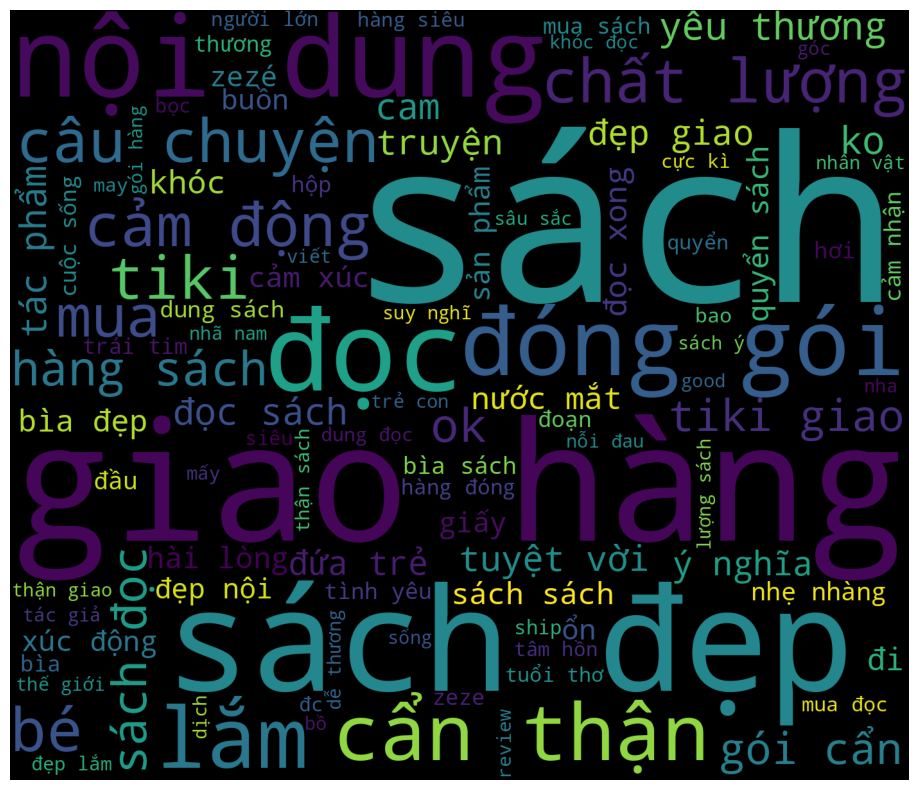

In [ ]:
from wordcloud import WordCloud
w_cloud = ' '.join(word for word in preprocess_df['preprocess_content'][(preprocess_df['rating'] == 5)])
plt.subplots(figsize=(15,10))
wordcloud = WordCloud(background_color='black', max_words=100, width=1400, height=1200).generate(w_cloud)
plt.imshow(wordcloud)
plt.axis('off')
plt.show()

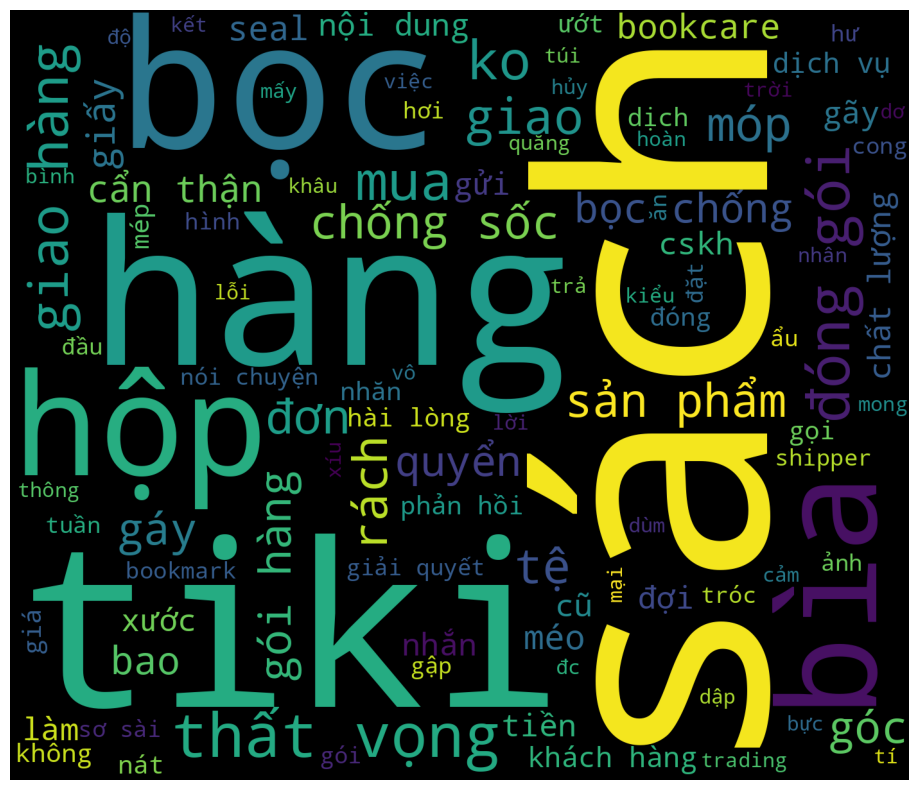

In [ ]:
w_cloud = ' '.join(word for word in preprocess_df['preprocess_content'][(preprocess_df['rating']==1) | (preprocess_df['rating'] == 2)].astype(str))
plt.subplots(figsize=(15,10))
wordcloud = WordCloud(background_color='black', max_words=100, width=1400, height=1200).generate(w_cloud)
plt.imshow(wordcloud)
plt.axis('off')
plt.show()

## Visualization

In [ ]:
!pip3 install pandas-profiling

In [ ]:
from pandas_profiling import ProfileReport
profile = ProfileReport(
    preprocess_df.drop('preprocess_content', axis = 1), title="Pandas Profiling Report dataset"
)
profile.to_notebook_iframe()

Summarize dataset:   0%|          | 0/5 [00:00<?, ?it/s]

Generate report structure:   0%|          | 0/1 [00:00<?, ?it/s]

Render HTML:   0%|          | 0/1 [00:00<?, ?it/s]

In [ ]:
numerical_cols = [feature for feature in preprocess_df.columns if preprocess_df[feature].dtype != 'O']
numerical_cols.remove('rating')
numerical_cols.remove('is_photo')
numerical_cols = np.array(numerical_cols).reshape(8, 2)
print('Numerical features: ', numerical_cols)

Numerical features:  [['comment_count' 'thank_count']
 ['score' 'response_day']
 ['review_created_year' 'review_created_month']
 ['review_created_day' 'review_created_hour']
 ['review_created_minute' 'review_created_second']
 ['delivery_year' 'delivery_month']
 ['delivery_day' 'delivery_hour']
 ['delivery_minute' 'delivery_second']]


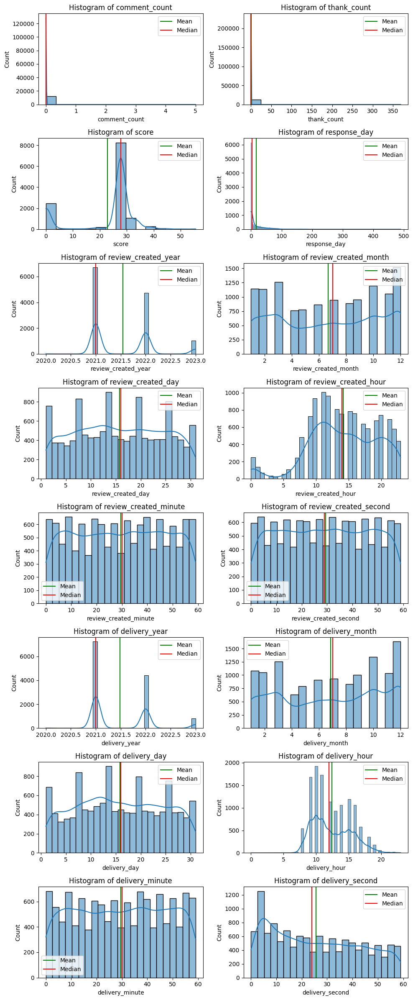

In [ ]:
fig, ax = plt.subplots(numerical_cols.shape[0], numerical_cols.shape[1], figsize = (10, 24))

for i in range(numerical_cols.shape[0]):
    for j in range(numerical_cols.shape[1]):
        sns.histplot(data = preprocess_df, x = numerical_cols[i, j], ax = ax[i, j], kde = True)
        ax[i, j].set_title('Histogram of ' + numerical_cols[i, j])
        ax[i, j].axvline(x = preprocess_df[numerical_cols[i, j]].mean(), color = 'green', label = 'Mean')
        ax[i, j].axvline(x = preprocess_df[numerical_cols[i, j]].median(), color = 'red', label = 'Median')
        ax[i, j].legend()

plt.tight_layout()
plt.show()

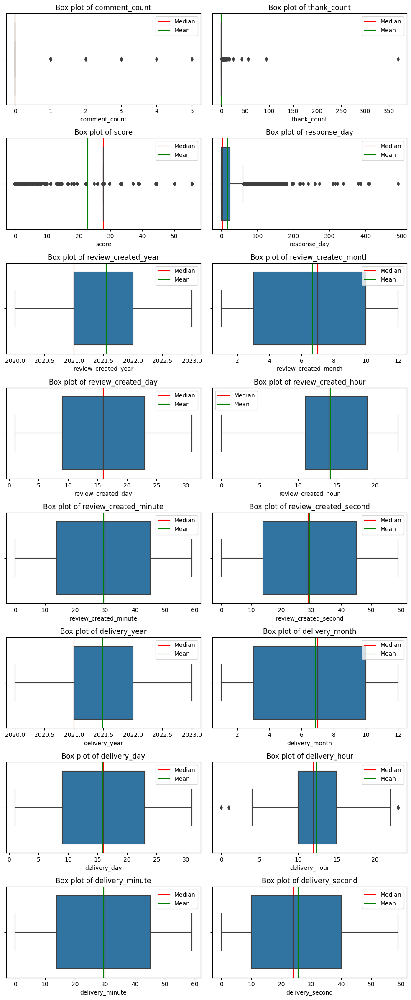

In [ ]:
fig, ax = plt.subplots(numerical_cols.shape[0], numerical_cols.shape[1], figsize = (10, 24))

for i in range(numerical_cols.shape[0]):
    for j in range(numerical_cols.shape[1]):
        sns.boxplot(data = preprocess_df, x = numerical_cols[i, j], ax = ax[i, j])
        ax[i, j].set_title('Box plot of ' + numerical_cols[i, j])
        ax[i, j].axvline(x = preprocess_df[numerical_cols[i, j]].median(), color = 'red', label = 'Median')
        ax[i, j].axvline(x = preprocess_df[numerical_cols[i, j]].mean(), color = 'green', label = 'Mean')
        ax[i, j].legend()

plt.tight_layout()
plt.show()

In [ ]:
count_rate = preprocess_df['rating'].value_counts().sort_index()
count_rate

1       51
2       41
3       96
4      873
5    11441
Name: rating, dtype: int64

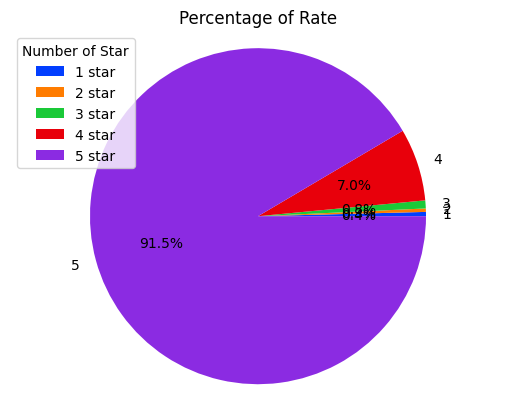

In [ ]:
plt.pie(count_rate, labels = ['1','2','3','4','5'], colors = sns.color_palette('bright')[0:], autopct='%1.1f%%', radius = 2)
plt.title('Percentage of Rate')
plt.legend(loc = 'upper left', labels = ['1 star','2 star','3 star','4 star','5 star'], title = 'Number of Star')
plt.axis('equal')
plt.show()

<ipython-input-211-1b753bbeb1fc>:1: FutureWarning: The default value of numeric_only in DataFrame.corr is deprecated. In a future version, it will default to False. Select only valid columns or specify the value of numeric_only to silence this warning.
  sns.heatmap(preprocess_df.corr(), annot = True, cmap = 'icefire', linewidth = .5, fmt ='.1f')


<Axes: >

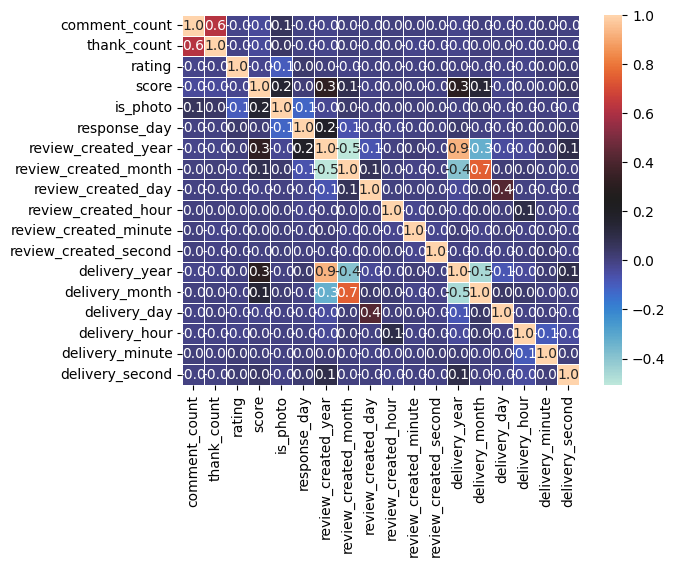

In [ ]:
sns.heatmap(preprocess_df.corr(), annot = True, cmap = 'icefire', linewidth = .5, fmt ='.1f')

# Feature Engineering

In [16]:
fe = preprocess_df.copy()

## Encoding

Ordinal variable: title

In [17]:
fe['title'].value_counts()

Cực kì hài lòng       11378
Hài lòng                933
Bình thường              85
Rất không hài lòng       50
Không hài lòng           41
Others                   15
Name: title, dtype: int64

In [18]:
from sklearn.preprocessing import LabelEncoder
Encoder = LabelEncoder()
fe['title'] = Encoder.fit_transform(fe['title'])

In [19]:
fe['title'].value_counts()

1    11378
2      933
0       85
5       50
3       41
4       15
Name: title, dtype: int64

nominal variable: is_photo

In [20]:
fe = pd.get_dummies(fe, prefix=['is_photo'], columns=['is_photo'])

In [21]:
fe.head()

,title,comment_count,thank_count,rating,score,response_day,review_created_year,review_created_month,review_created_day,review_created_hour,...,review_created_second,delivery_year,delivery_month,delivery_day,delivery_hour,delivery_minute,delivery_second,preprocess_content,is_photo_False,is_photo_True
0,1,5,369,5,0.021633,27,2021,10,11,21,...,12,2021,9,14,10,42,24,lấp hạnh phúc vết nứt tim an ủi chữa lành đi t...,0,1
1,1,0,12,5,0.017529,0,2022,7,7,22,...,37,2022,7,7,10,43,42,chê tiki gói hàng may sao hàng hư tẹo nèo hơi ...,0,1
2,1,3,25,5,0.015487,4,2021,12,25,21,...,51,2021,12,21,9,27,12,bìa cực xinh tiki giao hàng sách nhăn góc gãy ...,0,1
3,1,0,16,5,0.008848,0,2021,9,25,18,...,51,2021,9,25,13,26,8,nội dung sách bàn 1 tác phẩm văn học kinh điển...,0,1
4,1,2,1,5,0.041920,1,2022,12,8,1,...,33,2022,12,6,15,9,24,sách đọc tình yêu thương mất mát gợi ý hot cườ...,0,1


## Feature Selection

From heatmap above, delivery_year and review_created_year is multicollinearity so I drop 1 of them

thank_count and comment_count are nearly constant value (0 occupy 99% values)

In [22]:
fe.drop(['review_created_year','thank_count','comment_count'], axis = 1, inplace = True)

Assume that feature 'preprocess_content' is important for model, so how well does others affect to model ? I use ExtraTreeClassifier to perform feature_importance

In [ ]:
X = fe.drop(['rating','preprocess_content'], axis = 1)
Y = fe['rating']

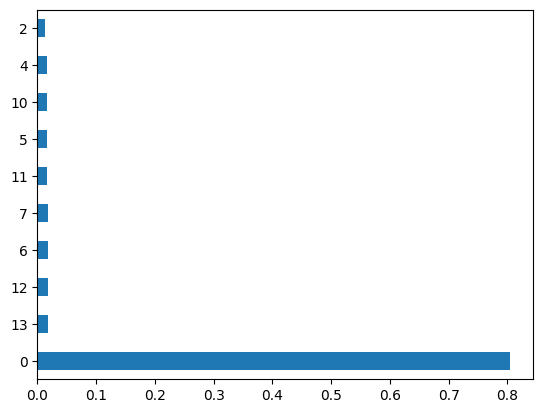

In [ ]:
from sklearn.ensemble import ExtraTreesClassifier

model = ExtraTreesClassifier(n_estimators=100)
model.fit(X, Y)
# print(model.feature_importances_)
f_importance = pd.DataFrame({'Feature_Name': X.columns, 'Weight_Importance': model.feature_importances_})
feat = pd.Series(model.feature_importances_)
feat = feat.reindex(range(len(feat)))
feat.nlargest(10).plot(kind = 'barh')
plt.show()

seem likes only title have really high effiective, but If I only use title and preprocess_content not sure model is gonna be better or worse, so I still keep them and reconsider after evaluate model

In [ ]:
f_importance_sorted = f_importance.sort_values(by='Weight_Importance', ascending=False)
f_importance_sorted = f_importance_sorted.reset_index(drop=True)
f_importance_sorted

,Feature_Name,Weight_Importance
0,title,0.804112
1,delivery_second,0.017767
2,delivery_minute,0.017596
3,review_created_minute,0.017298
4,review_created_second,0.017181
5,delivery_hour,0.016751
6,review_created_hour,0.016355
7,delivery_day,0.015826
8,review_created_day,0.015400
9,response_day,0.013244


## Handling Outlier

In [23]:
def imputate_outlier(data, feature, lower_bound, upper_bound, mode = None):
    # mode take mean, median, or IQR
    Q1 = data[feature].quantile(0.25) # or Q1 = np.percentile(df['column'], lower_bound)
    Q3 = data[feature].quantile(0.75)
    IQR = Q3 - Q1
    lower_extreme = Q1 - 1.5*IQR
    upper_extreme = Q3 + 1.5*IQR

    outliers = data[(data[feature] < lower_extreme) | (data[feature] > upper_extreme)]
    percent_outliers = len(outliers) / len(data) * 100
    print('Percent of outlier in',feature,':',percent_outliers)
    print('median of', feature,':', data[feature].median())
    print('mean of', feature,':', data[feature].mean())

    if mode == 'mean':
        data.loc[data[feature] < lower_extreme, feature] = data[feature].mean()
        data.loc[data[feature] > upper_extreme, feature] = data[feature].mean()
    elif mode == 'median':
        data.loc[data[feature] < lower_extreme, feature] = data[feature].median()
        data.loc[data[feature] > upper_extreme, feature] = data[feature].median()
    else: # IQR
        data.loc[data[feature] < lower_extreme, feature] = data[feature].quantile(lower_bound)
        data.loc[data[feature] > upper_extreme, feature] = data[feature].quantile(upper_bound)

    return data

In [24]:
# fe = imputate_outlier(fe, 'response_day', 0.25, 0.75, 'median')

# fe = imputate_outlier(fe, 'score', 0.25, 0.75, 'mean')

## Feature transformation

In [25]:
from sklearn.preprocessing import PowerTransformer
scaler = PowerTransformer(method = 'yeo-johnson')
'''
parameters:
method = 'box-cox' or 'yeo-johnson'
'''

"\nparameters:\nmethod = 'box-cox' or 'yeo-johnson'\n"

In [26]:
fe['score'] = scaler.fit_transform(fe['score'].values.reshape(-1, 1))
fe['response_day'] = scaler.fit_transform(fe['response_day'].values.reshape(-1, 1))

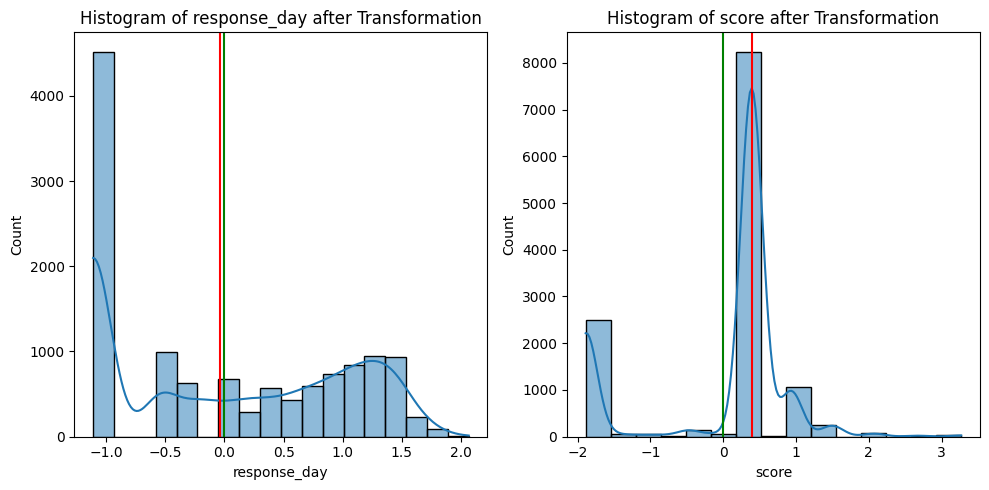

In [27]:
fig, ax = plt.subplots(ncols = 2, figsize = (10, 5))

sns.histplot(data = fe, x = 'response_day', ax = ax[0], kde = True)
ax[0].set_title('Histogram of response_day after Transformation')
ax[0].axvline(x = fe['response_day'].mean(), color = 'green', label = 'Mean')
ax[0].axvline(x = fe['response_day'].median(), color = 'red', label = 'Median')

sns.histplot(data = fe, x = 'score', ax = ax[1], kde = True)
ax[1].set_title('Histogram of score after Transformation')
ax[1].axvline(x = fe['score'].mean(), color = 'green', label = 'Mean')
ax[1].axvline(x = fe['score'].median(), color = 'red', label = 'Median')

plt.tight_layout()
plt.show()

## Feature extraction

In [28]:
from sklearn.feature_extraction.text import TfidfVectorizer
from tensorflow.keras.preprocessing.text import Tokenizer
from tensorflow.keras.preprocessing.sequence import pad_sequences

### TF-IDF

In [29]:
tf_idf_vectorizer =  TfidfVectorizer()
sequences = tf_idf_vectorizer.fit_transform(fe['preprocess_content'])
sequences

<12502x2914 sparse matrix of type '<class 'numpy.float64'>'
	with 35217 stored elements in Compressed Sparse Row format>

In [30]:
print('Shape of sequences from sparse matrix TF-IDF', sequences.toarray().shape)
seq_columns = [str(i) for i in range(sequences.shape[1] - 1)]
seq_columns[-1]

Shape of sequences from sparse matrix TF-IDF (12502, 2914)


'2912'

In [31]:
fe.shape

(12502, 18)

In [32]:
concatenated = np.hstack((fe.drop(['preprocess_content'], axis = 1).values, sequences.toarray()))

# Create a new dataframe with the concatenated values
fe_concatenated = pd.DataFrame(concatenated, columns=fe.columns.tolist() + seq_columns)
fe_concatenated.head()

,title,rating,score,response_day,review_created_month,review_created_day,review_created_hour,review_created_minute,review_created_second,delivery_year,...,2903,2904,2905,2906,2907,2908,2909,2910,2911,2912
0,1.0,5.0,-1.888289,1.051410,10.0,11.0,21.0,1.0,12.0,2021.0,...,0.0,0.0,0.0,0.0,0.0,0.091989,0.0,0.0,0.0,0.0
1,1.0,5.0,-1.888496,-1.108486,7.0,7.0,22.0,1.0,37.0,2022.0,...,0.0,0.0,0.0,0.0,0.0,0.000000,0.0,0.0,0.0,0.0
2,1.0,5.0,-1.888599,0.108292,12.0,25.0,21.0,33.0,51.0,2021.0,...,0.0,0.0,0.0,0.0,0.0,0.000000,0.0,0.0,0.0,0.0
3,1.0,5.0,-1.888933,-1.108486,9.0,25.0,18.0,17.0,51.0,2021.0,...,0.0,0.0,0.0,0.0,0.0,0.000000,0.0,0.0,0.0,0.0
4,1.0,5.0,-1.887263,-0.537603,12.0,8.0,1.0,48.0,33.0,2022.0,...,0.0,0.0,0.0,0.0,0.0,0.000000,0.0,0.0,0.0,0.0


### Option: tokenizer and zero-padding sequences

In [ ]:
# fe.preprocess_content.map(lambda x: len(x)).max()

1070

In [ ]:
# Vocab_size = 300
# MAX_SEQUENCE_LENGTH = fe.preprocess_content.map(lambda x: len(x)).max() + 1
# EMBEDDING_DIM = 100

# tokenizer = Tokenizer(num_words=Vocab_size, oov_token='<OOV>')
# tokenizer.fit_on_texts(fe['preprocess_content'].values)

In [ ]:
# sequences = tokenizer.texts_to_sequences(fe['preprocess_content'].values)
# sequences = pad_sequences(sequences, maxlen=MAX_SEQUENCE_LENGTH, padding = 'post')
# print('Shape of data tensor:', sequences.shape)
# print(sequences)

Shape of data tensor: (12502, 1071)
[[  1 225 277 ...   0   0   0]
 [256  10   7 ...   0   0   0]
 [ 15  41 109 ...   0   0   0]
 ...
 [  0   0   0 ...   0   0   0]
 [  0   0   0 ...   0   0   0]
 [  0   0   0 ...   0   0   0]]


In [ ]:
# seq_columns = [str(i) for i in range(sequences.shape[1] - 1)]

In [ ]:
# concatenated = np.hstack((fe.drop(['preprocess_content'], axis = 1).values, sequences))

# # Create a new dataframe with the concatenated values
# fe_concatenated = pd.DataFrame(concatenated, columns=fe.columns.tolist() + seq_columns)

# fe_concatenated.head()

,title,rating,score,response_day,review_created_month,review_created_day,review_created_hour,review_created_minute,review_created_second,delivery_year,...,1060,1061,1062,1063,1064,1065,1066,1067,1068,1069
0,1.0,5.0,-1.888289,1.051410,10.0,11.0,21.0,1.0,12.0,2021.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
1,1.0,5.0,-1.888496,-1.108486,7.0,7.0,22.0,1.0,37.0,2022.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
2,1.0,5.0,-1.888599,0.108292,12.0,25.0,21.0,33.0,51.0,2021.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
3,1.0,5.0,-1.888933,-1.108486,9.0,25.0,18.0,17.0,51.0,2021.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
4,1.0,5.0,-1.887263,-0.537603,12.0,8.0,1.0,48.0,33.0,2022.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0


## Handling imbalanced data

In [ ]:
count_rate = fe_concatenated['rating'].value_counts().sort_index()
count_rate

1.0       51
2.0       41
3.0       96
4.0      873
5.0    11441
Name: 3, dtype: int64

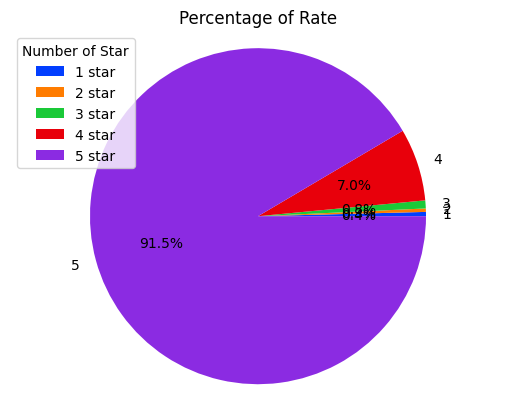

In [ ]:
plt.pie(count_rate, labels = ['1','2','3','4','5'], colors = sns.color_palette('bright')[0:], autopct='%1.1f%%', radius = 2)
plt.title('Percentage of Rate')
plt.legend(loc = 'upper left', labels = ['1 star','2 star','3 star','4 star','5 star'], title = 'Number of Star')
plt.axis('equal')
plt.show()

In [33]:
from imblearn.over_sampling import SMOTE
# Resampling the multi-minority class.
sm = SMOTE(sampling_strategy='auto', random_state=42)

oversampled_X, oversampled_Y = sm.fit_resample(fe_concatenated.drop('rating', axis = 1), fe_concatenated['rating'])
oversampled = pd.concat([pd.DataFrame(oversampled_Y), pd.DataFrame(oversampled_X)], axis=1)

In [ ]:
print('Before resample:', fe_concatenated.shape)
print('After resample:', oversampled.shape)

Before resample: (12502, 2931)
After resample: (57205, 2931)


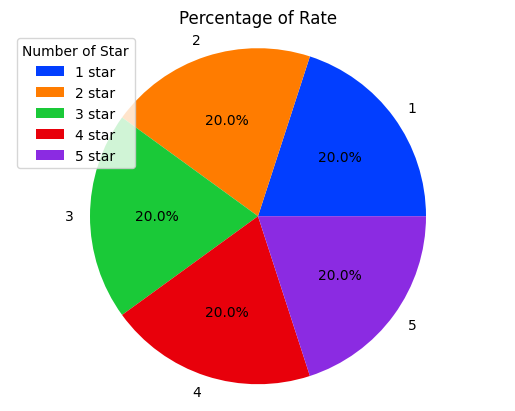

In [ ]:
count_rate = oversampled['rating'].value_counts().sort_index()

plt.pie(count_rate, labels = ['1','2','3','4','5'], colors = sns.color_palette('bright')[0:], autopct='%1.1f%%', radius = 2)
plt.title('Percentage of Rate')
plt.legend(loc = 'upper left', labels = ['1 star','2 star','3 star','4 star','5 star'], title = 'Number of Star')
plt.axis('equal')
plt.show()

## Reduce dimension & Splitting

I recommend this step should be use in pipeline for automatically hyperparameter tuning, but I use google colab only 12GB RAM and it will crash =)) so I manually separate it to run model step by step same as pipeline

In [34]:
from sklearn.preprocessing import StandardScaler, MinMaxScaler
from sklearn.decomposition import PCA
from sklearn.model_selection import train_test_split

In [35]:
X = oversampled.drop('rating', axis = 1)
Y = oversampled['rating']

In [36]:
X_train, X_test, Y_train, Y_test = train_test_split(X, Y, test_size = 0.3, random_state = 42)

I have experimented Scaler but it not work well as Unscale

In [ ]:
# scaler = StandardScaler()
# X_train = scaler.fit_transform(X_train)
# X_test = scaler.transform(X_test)

In [37]:
pca = PCA(n_components = 7)
X_train = pca.fit_transform(X_train)
X_test = pca.transform(X_test)

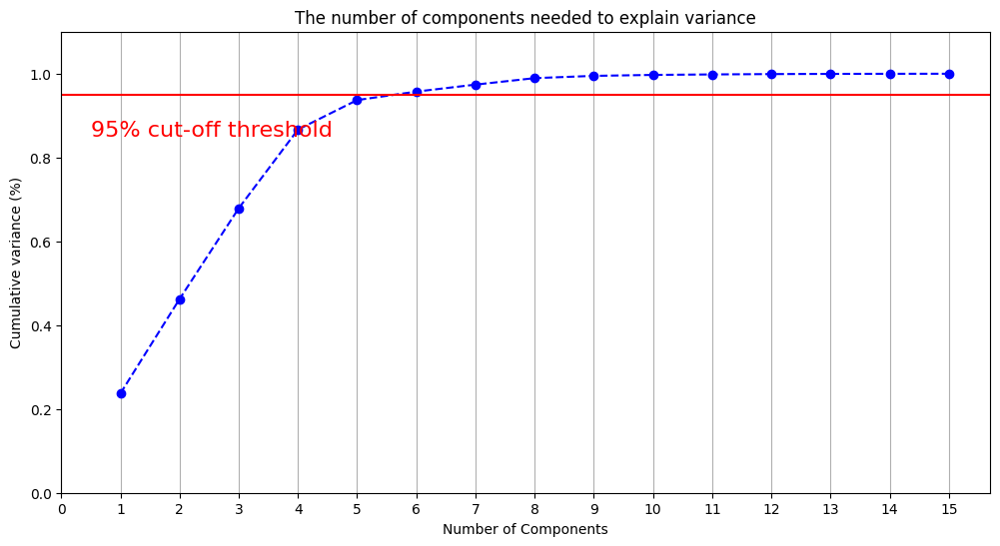

In [ ]:
pca = PCA().fit(X)

plt.rcParams["figure.figsize"] = (12,6)

fig, ax = plt.subplots()
xi = np.arange(1, 16, step=1)
y = np.cumsum(pca.explained_variance_ratio_[:15])

plt.ylim(0.0,1.1)
plt.plot(xi, y, marker='o', linestyle='--', color='b')

plt.xlabel('Number of Components')
plt.xticks(np.arange(0, 16, step=1)) #change from 0-based array index to 1-based human-readable label
plt.ylabel('Cumulative variance (%)')
plt.title('The number of components needed to explain variance')

plt.axhline(y=0.95, color='r', linestyle='-')
plt.text(0.5, 0.85, '95% cut-off threshold', color = 'red', fontsize=16)

ax.grid(axis='x')
plt.show()

# Machine Learning Model

In [55]:
from sklearn.linear_model import LogisticRegression
from sklearn.naive_bayes import GaussianNB, ComplementNB, MultinomialNB
from sklearn.neighbors import KNeighborsClassifier
from sklearn.svm import SVC
from sklearn import tree
from sklearn.tree import DecisionTreeClassifier
from sklearn.ensemble import RandomForestClassifier
from xgboost import XGBClassifier

In [39]:
from sklearn.model_selection import KFold, StratifiedKFold

from sklearn.metrics import accuracy_score, precision_score, recall_score, f1_score, roc_auc_score, \
                        confusion_matrix, classification_report, ConfusionMatrixDisplay
from sklearn.pipeline import make_pipeline, Pipeline
from sklearn.model_selection import GridSearchCV

def evaluate_model(y_true, y_pred):
    """
    :param y_true: ground truth values
    :param y_pred: predictions
    """
    print("accuracy", accuracy_score(y_true, y_pred))
    print("precision", precision_score(y_true, y_pred, average = 'weighted'))
    print("recall", recall_score(y_true, y_pred, average = 'weighted'))
    print("F1", f1_score(y_true, y_pred, average = 'weighted'))
    # print("ROC_AUC ", roc_auc_score(y_true, y_pred, average = 'weighted'))

    report = classification_report(y_true, y_pred)
    print("Classification Report\n",report)

    cm = confusion_matrix(y_true,y_pred)
	# tn, fp, fn, tp = confusion_matrix(test_labels, y_pred).ravel()
    display_label = np.unique(y_true)
    cm_display = ConfusionMatrixDisplay(confusion_matrix = cm, display_labels = display_label)
    cm_display.plot()
    plt.show()

    compare_df = pd.DataFrame({'Actual': y_true, 'Predict': y_pred})
    print(compare_df)

In [40]:
def kfold_save_model(model_chosen, X, y, n_splits=5):
    kf = KFold(n_splits=n_splits, shuffle=True, random_state = 42)
    best_score = 0
    best_dataset = None
    for i, (train_index, test_index) in enumerate(kf.split(X)):
        print(f'Fold {i+1}th in total {n_splits} Fold')
        X_train, X_test = X.iloc[train_index,:], X.iloc[test_index,:]
        y_train, y_test = y.iloc[train_index], y.iloc[test_index]

        # Build model with Data train
        model = model_chosen(X_train, y_train)

        # Evaluate
        y_pred = model.predict(X_test)
        score = precision_score(y_test, y_pred, average = 'weighted')
        # score = model.score(X_test, y_test)

        # save best model and data train with best score
        if score > best_score:
            best_score = score
            best_dataset = (X_train, X_test, y_train, y_test)
            best_model = model

    # Train your best model using the best dataset (X_train, y_train) and return the trained model
    print('Taking best model with best data train')
    X_train_best, _, y_train_best, _ = best_dataset
    best_model.fit(X_train_best, y_train_best)
    print("Best parameter (CV score=%0.3f):" % model.best_score_)
    print(model.best_params_)

    return best_model, best_dataset

## Logistic Regression

In [41]:
def build_model_LogReg(X, y):

    pipe = Pipeline(steps=[
                            # ("scaler", StandardScaler()),
                            # ("pca", PCA(n_components = 7)),
                            ("LogReg", LogisticRegression(penalty = 'l2', multi_class ='multinomial', random_state = 42))],
                     verbose = True)
    param_grid = {
        'LogReg__C': [1, 1E3, 1E6],
        'LogReg__solver': ['sag', 'saga', 'lbfgs', 'newton-cg'],
        }
    model = GridSearchCV(pipe, param_grid, scoring = 'accuracy', n_jobs = 2)
    model.fit(X, y)

    return model

If you wanna use cross-validation + gridsearch just run here, but I use google colab with only 12GB RAM and will crash with this data =)) so I dont run it, I use holdout (train_test_split) to experiment

In [ ]:
# %%time
# model, dataset = kfold_save_model(build_model_LogReg, X, Y, 5)

# X_train, X_test, Y_train, Y_test = dataset
# X_train.shape, X_test.shape, Y_train.shape, Y_test.shape

Fold 1th in total 5 Fold


In [42]:
%%time
LogReg_model = build_model_LogReg(X_train, Y_train)

[Pipeline] ............ (step 1 of 1) Processing LogReg, total=   0.4s
CPU times: user 761 ms, sys: 125 ms, total: 886 ms
Wall time: 28.1 s


accuracy 0.27368605057685585
precision 0.3466319152021718
recall 0.27368605057685585
F1 0.29893570662706076
Classification Report
               precision    recall  f1-score   support

         1.0       0.33      0.26      0.29      4330
         2.0       0.42      0.31      0.36      4579
         3.0       0.44      0.29      0.35      5131
         4.0       0.13      0.19      0.15      2366
         5.0       0.06      0.26      0.09       756

    accuracy                           0.27     17162
   macro avg       0.27      0.26      0.25     17162
weighted avg       0.35      0.27      0.30     17162



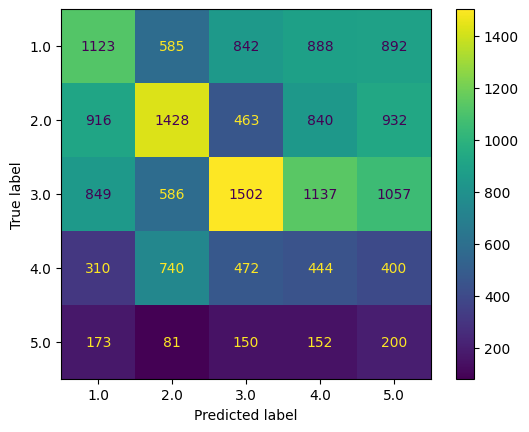

       Actual  Predict
56294     3.0      4.0
37188     1.0      3.0
37762     3.0      3.0
48301     1.0      4.0
37343     4.0      3.0
...       ...      ...
54470     3.0      4.0
810       2.0      5.0
36742     3.0      3.0
43103     3.0      3.0
2259      2.0      5.0

[17162 rows x 2 columns]


In [43]:
y_pred = LogReg_model.predict(X_test)

evaluate_model(y_pred, Y_test)

## SVM

In [44]:
def build_model_SVM(X, y):

    pipe = Pipeline(steps=[
                            # ("scaler", StandardScaler()),
                            # ("pca", PCA(n_components = 7)),
                            ("svm", SVC(random_state = 42, max_iter = 10000))], verbose = True)
    param_grid = {
        'svm__C': [1, 1E3, 1E6, 1E9],
        'svm__kernel': ['poly', 'rbf'],
        }
    model = GridSearchCV(pipe, param_grid, scoring = 'accuracy', n_jobs = 2)
    model.fit(X, y)

    return model

In [ ]:
# # For using K-fold validation
# %%time
# model, dataset = kfold_save_model(build_model_SVM, X, Y, 5)

# X_train, X_test, Y_train, Y_test = dataset
# X_train.shape, X_test.shape, Y_train.shape, Y_test.shape

In [45]:
SVM_model = build_model_SVM(X_train, Y_train)

[Pipeline] ............... (step 1 of 1) Processing svm, total=  17.0s


/usr/local/lib/python3.10/dist-packages/sklearn/svm/_base.py:299: ConvergenceWarning: Solver terminated early (max_iter=10000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  warnings.warn(


accuracy 0.760167812609253
precision 0.7569445592756848
recall 0.760167812609253
F1 0.758236630989928
Classification Report
               precision    recall  f1-score   support

         1.0       0.92      0.95      0.93      3277
         2.0       1.00      0.97      0.98      3526
         3.0       0.83      0.88      0.85      3204
         4.0       0.57      0.56      0.56      3531
         5.0       0.50      0.48      0.49      3624

    accuracy                           0.76     17162
   macro avg       0.76      0.77      0.76     17162
weighted avg       0.76      0.76      0.76     17162



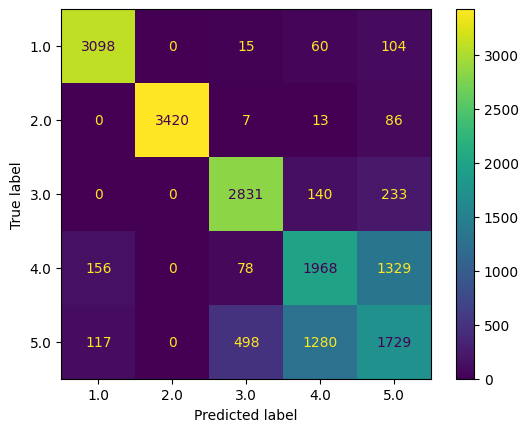

       Actual  Predict
56294     4.0      4.0
37188     3.0      3.0
37762     3.0      3.0
48301     4.0      4.0
37343     3.0      3.0
...       ...      ...
54470     4.0      4.0
810       5.0      5.0
36742     3.0      3.0
43103     3.0      3.0
2259      4.0      5.0

[17162 rows x 2 columns]


In [46]:
y_pred = SVM_model.predict(X_test)

evaluate_model(y_pred, Y_test)

No cross-validation, TF-IDF + handle imbalance + PCA(n = 7)

accuracy 0.756205570446335
precision 0.8204051840863535
recall 0.756205570446335
F1 0.7773792653234951
Classification Report
               precision    recall  f1-score   support

         1.0       0.97      0.79      0.87      4110
         2.0       0.96      0.84      0.90      3906
         3.0       0.94      0.76      0.84      4222
         4.0       0.55      0.62      0.59      3061
         5.0       0.37      0.70      0.49      1863

    accuracy                           0.76     17162
   macro avg       0.76      0.74      0.74     17162
weighted avg       0.82      0.76      0.78     17162



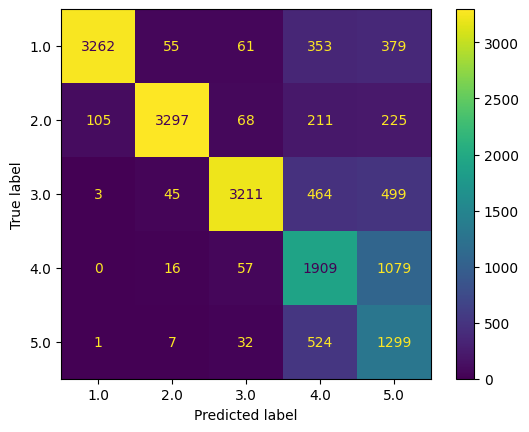

       Actual  Predict
56294     3.0      4.0
37188     3.0      3.0
37762     3.0      3.0
48301     5.0      4.0
37343     3.0      3.0
...       ...      ...
54470     4.0      4.0
810       4.0      5.0
36742     3.0      3.0
43103     3.0      3.0
2259      4.0      5.0

[17162 rows x 2 columns]


In [ ]:
y_pred = SVM_model.predict(X_test)

evaluate_model(y_pred, y_test)

## Naive Bayes

I only experiment Gaussian NB cause ComplementNB and MultinomialNB dont fit with negative values, others dont correct

In [47]:
def build_model_GaussianNB(X, y):

    pipe = Pipeline(steps=[
                            # ("scaler", StandardScaler()),
                            # ("pca", PCA(n_components = 7)),
                            ("NB", GaussianNB())], verbose = True)
    param_grid = {
        'NB__var_smoothing': np.logspace(-1, -9, num=200)
        }
    model = GridSearchCV(pipe, param_grid, scoring = 'accuracy', n_jobs = 1)
    model.fit(X, y)

    return model

In [ ]:
# # For using K-fold validation
# %%time
# model, dataset = kfold_save_model(build_model_GaussianNB, X, Y, 5)

# X_train, X_test, Y_train, Y_test = dataset
# X_train.shape, X_test.shape, Y_train.shape, Y_test.shape

In [48]:
%%time
NB_model = build_model_GaussianNB(X_train, Y_train)

[Pipeline] ................ (step 1 of 1) Processing NB, total=   0.0s
[Pipeline] ................ (step 1 of 1) Processing NB, total=   0.0s
[Pipeline] ................ (step 1 of 1) Processing NB, total=   0.0s
[Pipeline] ................ (step 1 of 1) Processing NB, total=   0.0s
[Pipeline] ................ (step 1 of 1) Processing NB, total=   0.0s
[Pipeline] ................ (step 1 of 1) Processing NB, total=   0.0s
[Pipeline] ................ (step 1 of 1) Processing NB, total=   0.0s
[Pipeline] ................ (step 1 of 1) Processing NB, total=   0.0s
[Pipeline] ................ (step 1 of 1) Processing NB, total=   0.0s
[Pipeline] ................ (step 1 of 1) Processing NB, total=   0.0s
[Pipeline] ................ (step 1 of 1) Processing NB, total=   0.0s
[Pipeline] ................ (step 1 of 1) Processing NB, total=   0.0s
[Pipeline] ................ (step 1 of 1) Processing NB, total=   0.0s
[Pipeline] ................ (step 1 of 1) Processing NB, total=   0.0s
[Pipel

accuracy 0.3466379209882298
precision 0.44636983731093705
recall 0.3466379209882298
F1 0.3688004195680362
Classification Report
               precision    recall  f1-score   support

         1.0       0.66      0.34      0.45      6592
         2.0       0.26      0.32      0.29      2749
         3.0       0.44      0.35      0.39      4263
         4.0       0.15      0.37      0.21      1373
         5.0       0.24      0.37      0.29      2185

    accuracy                           0.35     17162
   macro avg       0.35      0.35      0.33     17162
weighted avg       0.45      0.35      0.37     17162



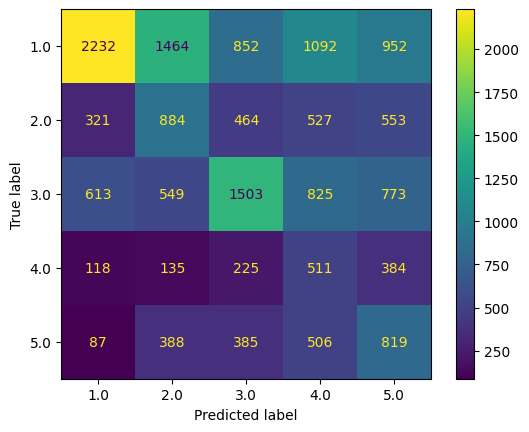

       Actual  Predict
56294     3.0      4.0
37188     1.0      3.0
37762     3.0      3.0
48301     5.0      4.0
37343     4.0      3.0
...       ...      ...
54470     4.0      4.0
810       5.0      5.0
36742     3.0      3.0
43103     5.0      3.0
2259      2.0      5.0

[17162 rows x 2 columns]


In [49]:
y_pred = NB_model.predict(X_test)

evaluate_model(y_pred, Y_test)

## KNN

In [50]:
def build_model_KNN(X, y):

    pipe = Pipeline(steps=[
                            # ("scaler", StandardScaler()),
                            # ("pca", PCA(n_components = 7)),
                            ("KNN", KNeighborsClassifier())], verbose = True)
    param_grid = {
        'KNN__algorithm': ['auto', 'ball_tree', 'kd_tree', 'brute']
        }
    model = GridSearchCV(pipe, param_grid, scoring = 'accuracy', n_jobs = 1)
    model.fit(X, y)

    return model

In [ ]:
# # For using K-fold validation
# %%time
# model, dataset = kfold_save_model(build_model_KNN, X, Y, 5)

# X_train, X_test, Y_train, Y_test = dataset
# X_train.shape, X_test.shape, Y_train.shape, Y_test.shape

In [51]:
%%time
KNN_model = build_model_KNN(X_train, Y_train)

[Pipeline] ............... (step 1 of 1) Processing KNN, total=   0.0s
[Pipeline] ............... (step 1 of 1) Processing KNN, total=   0.0s
[Pipeline] ............... (step 1 of 1) Processing KNN, total=   0.0s
[Pipeline] ............... (step 1 of 1) Processing KNN, total=   0.0s
[Pipeline] ............... (step 1 of 1) Processing KNN, total=   0.0s
[Pipeline] ............... (step 1 of 1) Processing KNN, total=   0.0s
[Pipeline] ............... (step 1 of 1) Processing KNN, total=   0.0s
[Pipeline] ............... (step 1 of 1) Processing KNN, total=   0.0s
[Pipeline] ............... (step 1 of 1) Processing KNN, total=   0.0s
[Pipeline] ............... (step 1 of 1) Processing KNN, total=   0.0s
[Pipeline] ............... (step 1 of 1) Processing KNN, total=   0.1s
[Pipeline] ............... (step 1 of 1) Processing KNN, total=   0.1s
[Pipeline] ............... (step 1 of 1) Processing KNN, total=   0.1s
[Pipeline] ............... (step 1 of 1) Processing KNN, total=   0.0s
[Pipel

accuracy 0.8938934856077381
precision 0.9431557518396035
recall 0.8938934856077381
F1 0.9064006646475476
Classification Report
               precision    recall  f1-score   support

         1.0       1.00      0.92      0.96      3666
         2.0       1.00      0.94      0.97      3647
         3.0       1.00      0.91      0.95      3767
         4.0       0.98      0.78      0.87      4330
         5.0       0.50      0.99      0.67      1752

    accuracy                           0.89     17162
   macro avg       0.90      0.91      0.88     17162
weighted avg       0.94      0.89      0.91     17162



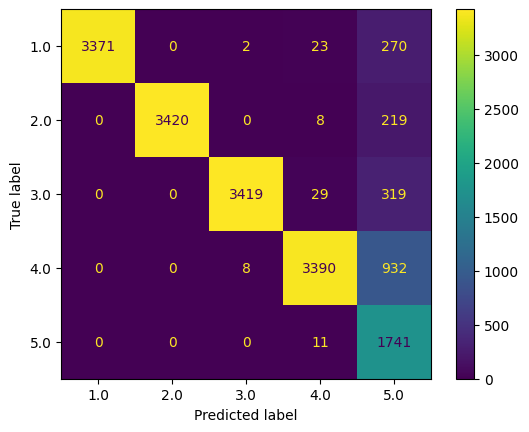

       Actual  Predict
56294     4.0      4.0
37188     3.0      3.0
37762     3.0      3.0
48301     4.0      4.0
37343     3.0      3.0
...       ...      ...
54470     4.0      4.0
810       5.0      5.0
36742     3.0      3.0
43103     3.0      3.0
2259      4.0      5.0

[17162 rows x 2 columns]


In [52]:
y_pred = KNN_model.predict(X_test)

evaluate_model(y_pred, Y_test)

## Decision Tree Classification

In [56]:
def build_model_DecisionTree(X, y):

    pipe = Pipeline(steps=[ ("tree", DecisionTreeClassifier(random_state = 42))], verbose = True)
    param_grid = {
        'tree__criterion': ['gini', 'entropy', 'log_loss'],
        'tree__max_depth': [10, 20, 50, 100, 200, 300, None],
        'tree__min_samples_leaf': [1, 2, 3, 4, 5],
        'tree__max_features': ['auto', 'sqrt', 'log2', 'None']
        }
    model = GridSearchCV(pipe, param_grid, scoring = 'recall', n_jobs = 4)
    model.fit(X, y)

    return model

In [ ]:
# %%time
# model, dataset = kfold_save_model(build_model_DecisionTree, X, Y, 5)

# X_train, X_test, Y_train, Y_test = dataset
# X_train.shape, X_test.shape, Y_train.shape, Y_test.shape

Fold 1th in total 5 Fold


In [57]:
%%time
DecisionTree_model = build_model_DecisionTree(X_train, Y_train)

[Pipeline] .............. (step 1 of 1) Processing tree, total=   0.1s
CPU times: user 6.46 s, sys: 1.1 s, total: 7.56 s
Wall time: 4min 19s


/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py:378: FitFailedWarning: 
525 fits failed out of a total of 2100.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
174 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/pipeline.py", line 405, in fit
    self._final_estimator.fit(Xt, y, **fit_params_last_step)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/tree/_classes.py", line 889, in fit
    super().fit(
  File "/usr/local/lib/python3.10/dist-packages/sklearn

accuracy 0.593928446567999
precision 0.6547387440485728
recall 0.593928446567999
F1 0.6119630443505208
Classification Report
               precision    recall  f1-score   support

         1.0       0.72      0.65      0.68      3741
         2.0       0.81      0.69      0.75      4024
         3.0       0.72      0.52      0.61      4710
         4.0       0.46      0.49      0.48      3249
         5.0       0.26      0.64      0.37      1438

    accuracy                           0.59     17162
   macro avg       0.60      0.60      0.58     17162
weighted avg       0.65      0.59      0.61     17162



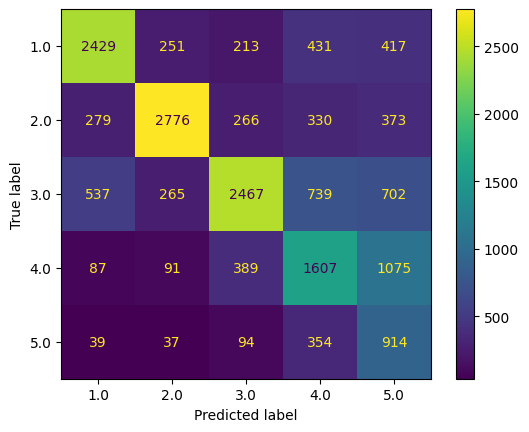

       Actual  Predict
56294     2.0      4.0
37188     3.0      3.0
37762     3.0      3.0
48301     4.0      4.0
37343     4.0      3.0
...       ...      ...
54470     4.0      4.0
810       2.0      5.0
36742     5.0      3.0
43103     4.0      3.0
2259      4.0      5.0

[17162 rows x 2 columns]


In [58]:
y_pred = DecisionTree_model.predict(X_test)

evaluate_model(y_pred, Y_test)

## Random Forest Classification

In [60]:
def build_model_RandomForest(X, y):

    pipe = Pipeline(steps=[ ("tree", RandomForestClassifier(random_state = 42, n_jobs = -1))], verbose = True)
    param_grid = {
        'tree__n_estimators': [50, 100, 200],
        'tree__criterion': ['gini','entropy','log_loss'],
        'tree__max_features': [None, 'auto', 'sqrt', 'log2']
        }
    model = GridSearchCV(pipe, param_grid, scoring = 'recall', n_jobs = 3)
    model.fit(X, y)

    return model

In [ ]:
# %%time
# model, dataset = kfold_save_model(build_model_RandomForest, X, Y, 5)

# X_train, X_test, Y_train, Y_test = dataset
# X_train.shape, X_test.shape, Y_train.shape, Y_test.shape

In [61]:
%%time
RandomForest_model = build_model_RandomForest(X_train, Y_train)

/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_search.py:952: UserWarning: One or more of the test scores are non-finite: [nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan]
  warnings.warn(


[Pipeline] .............. (step 1 of 1) Processing tree, total=  10.8s
CPU times: user 31.3 s, sys: 1.39 s, total: 32.7 s
Wall time: 45min 21s


accuracy 0.9387017830089733
precision 0.9440939047990978
recall 0.9387017830089733
F1 0.9401857957059195
Classification Report
               precision    recall  f1-score   support

         1.0       1.00      0.97      0.99      3460
         2.0       1.00      0.97      0.99      3508
         3.0       1.00      0.96      0.98      3561
         4.0       0.92      0.87      0.89      3662
         5.0       0.78      0.92      0.85      2971

    accuracy                           0.94     17162
   macro avg       0.94      0.94      0.94     17162
weighted avg       0.94      0.94      0.94     17162



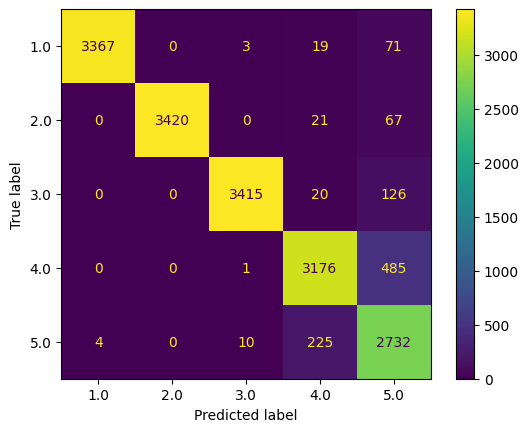

       Actual  Predict
56294     4.0      4.0
37188     3.0      3.0
37762     3.0      3.0
48301     4.0      4.0
37343     3.0      3.0
...       ...      ...
54470     4.0      4.0
810       5.0      5.0
36742     3.0      3.0
43103     3.0      3.0
2259      5.0      5.0

[17162 rows x 2 columns]


In [63]:
y_pred = RandomForest_model.predict(X_test)

evaluate_model(y_pred, Y_test)

accuracy 0.9999750268461404
precision 0.9999750299834712
recall 0.9999750268461404
F1 0.9999750268482044
Classification Report
               precision    recall  f1-score   support

         1.0       1.00      1.00      1.00      8070
         2.0       1.00      1.00      1.00      8021
         3.0       1.00      1.00      1.00      8012
         4.0       1.00      1.00      1.00      7981
         5.0       1.00      1.00      1.00      7959

    accuracy                           1.00     40043
   macro avg       1.00      1.00      1.00     40043
weighted avg       1.00      1.00      1.00     40043



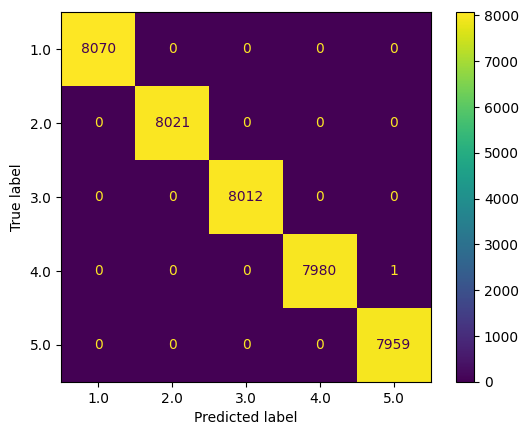

       Actual  Predict
1335      5.0      5.0
36872     3.0      3.0
28221     2.0      2.0
47072     4.0      4.0
538       5.0      5.0
...       ...      ...
54343     4.0      4.0
38158     3.0      3.0
860       5.0      5.0
15795     1.0      1.0
56422     4.0      4.0

[40043 rows x 2 columns]


In [64]:
y_pred = RandomForest_model.predict(X_train)

evaluate_model(y_pred, Y_train)

## XGB

XGB take target from value 0 so I minus 1 from 1 2 3 4 5 -> 0 1 2 3 4

In [53]:
XGB_model = XGBClassifier(random_state = 42)
XGB_model.fit(X_train, Y_train-1)

XGBClassifier(base_score=None, booster=None, callbacks=None,
              colsample_bylevel=None, colsample_bynode=None,
              colsample_bytree=None, early_stopping_rounds=None,
              enable_categorical=False, eval_metric=None, feature_types=None,
              gamma=None, gpu_id=None, grow_policy=None, importance_type=None,
              interaction_constraints=None, learning_rate=None, max_bin=None,
              max_cat_threshold=None, max_cat_to_onehot=None,
              max_delta_step=None, max_depth=None, max_leaves=None,
              min_child_weight=None, missing=nan, monotone_constraints=None,
              n_estimators=100, n_jobs=None, num_parallel_tree=None,
              objective='multi:softprob', predictor=None, ...)

accuracy 0.8933690712038224
precision 0.9058821510184897
recall 0.8933690712038224
F1 0.8972765839184579
Classification Report
               precision    recall  f1-score   support

           0       0.99      0.93      0.96      3600
           1       1.00      0.96      0.98      3541
           2       0.98      0.92      0.95      3662
           3       0.83      0.79      0.81      3627
           4       0.67      0.85      0.75      2732

    accuracy                           0.89     17162
   macro avg       0.89      0.89      0.89     17162
weighted avg       0.91      0.89      0.90     17162



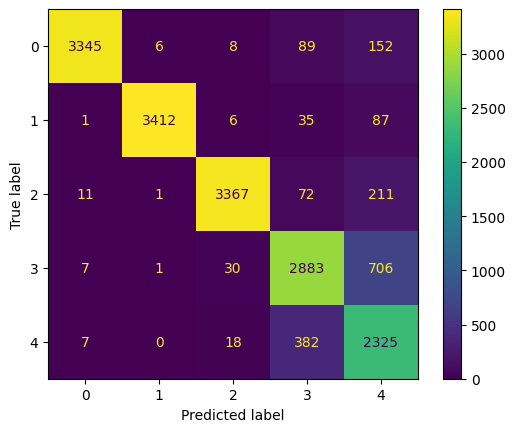

       Actual  Predict
56294       3      3.0
37188       2      2.0
37762       2      2.0
48301       3      3.0
37343       2      2.0
...       ...      ...
54470       3      3.0
810         4      4.0
36742       2      2.0
43103       2      2.0
2259        3      4.0

[17162 rows x 2 columns]


In [54]:
y_pred = XGB_model.predict(X_test)

evaluate_model(y_pred, Y_test-1)

accuracy 0.8933690712038224
precision 0.9058821510184897
recall 0.8933690712038224
F1 0.8972765839184579
Classification Report
               precision    recall  f1-score   support

           0       0.99      0.93      0.96      3600
           1       1.00      0.96      0.98      3541
           2       0.98      0.92      0.95      3662
           3       0.83      0.79      0.81      3627
           4       0.67      0.85      0.75      2732

    accuracy                           0.89     17162
   macro avg       0.89      0.89      0.89     17162
weighted avg       0.91      0.89      0.90     17162



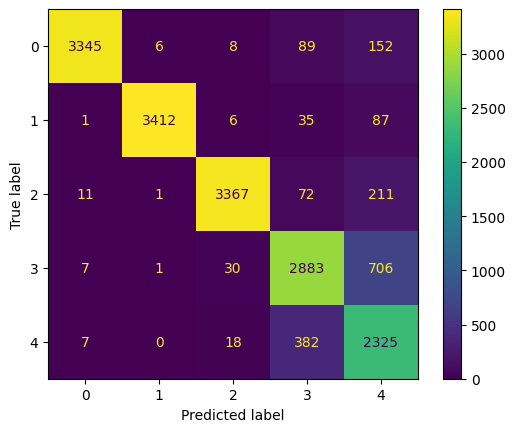

       Actual  Predict
56294       3      3.0
37188       2      2.0
37762       2      2.0
48301       3      3.0
37343       2      2.0
...       ...      ...
54470       3      3.0
810         4      4.0
36742       2      2.0
43103       2      2.0
2259        3      4.0

[17162 rows x 2 columns]


In [ ]:
y_pred = XGB_model.predict(X_test)

evaluate_model(y_pred, Y_test-1)

## Comparision ML performance

In [69]:
model_name = ['LogisticRegression', 'SVM', 'Naive Bayes', 'KNN', 'DecisionTree', 'RandomForest', 'XGB']
accuracy_score_test = []
accuracy_score_train = []
for i in [LogReg_model, SVM_model, NB_model, KNN_model, DecisionTree_model, RandomForest_model]:
    y_pred = i.predict(X_test)
    s = accuracy_score(Y_test, y_pred)
    accuracy_score_test.append(s)

    y_pred = i.predict(X_train)
    s = accuracy_score(Y_train, y_pred)
    accuracy_score_train.append(s)

# XGB model, cause I have to minus 1 in label
y_pred = XGB_model.predict(X_test)
accuracy_score_test.append(accuracy_score(Y_test-1, y_pred))
y_pred = XGB_model.predict(X_train)
accuracy_score_train.append(accuracy_score(Y_train-1, y_pred))

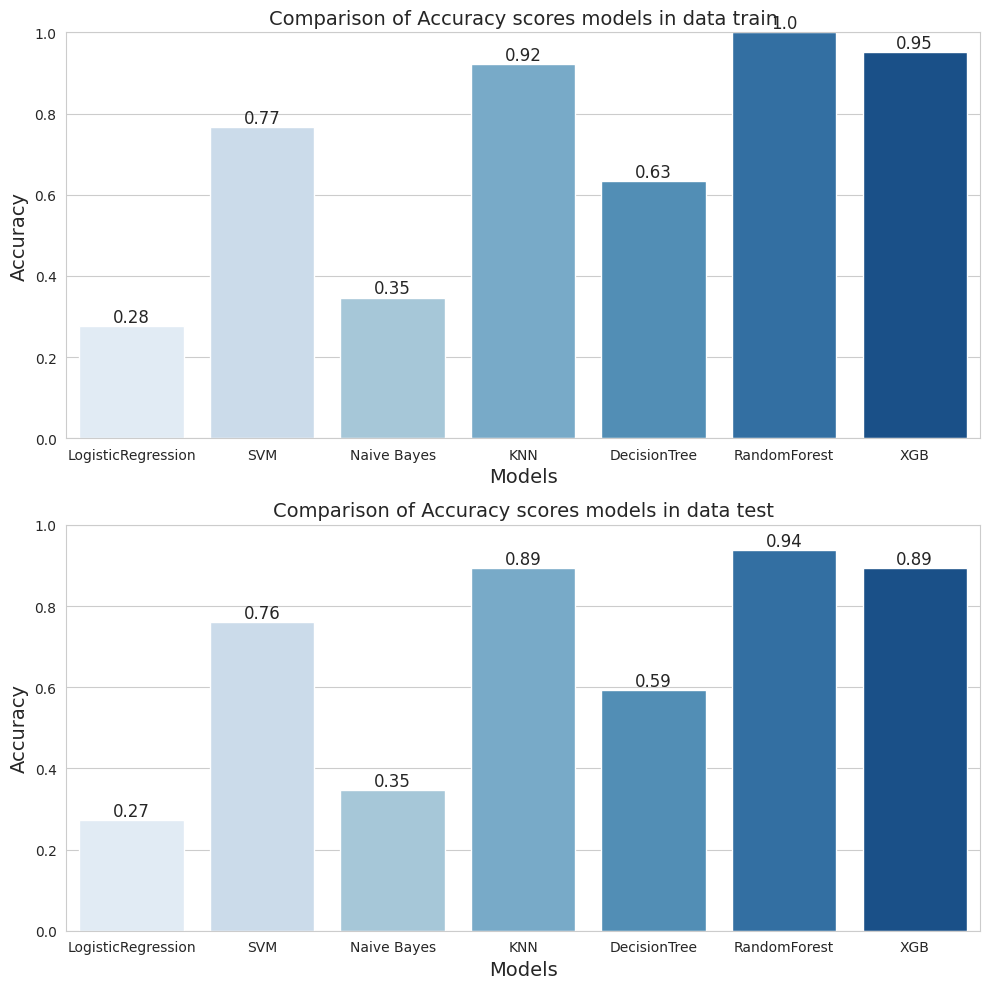

In [76]:
sns.set_style("whitegrid")
fig, ax = plt.subplots(nrows = 2, figsize = (10, 10))
sns.barplot(x=model_name, y=accuracy_score_train, ax = ax[0], palette="Blues")
ax[0].set_ylim(0, 1.0)

# add text labels to the bars
for i, score in enumerate(accuracy_score_train):
    ax[0].text(i, score+0.01, round(score, 2), ha='center', fontsize=12)

ax[0].set_title('Comparison of Accuracy scores models in data train', fontsize=14)
ax[0].set_xlabel('Models', fontsize=14)
ax[0].set_ylabel('Accuracy', fontsize=14)

sns.barplot(x=model_name, y=accuracy_score_test, ax = ax[1], palette="Blues")
ax[1].set_ylim(0, 1.0)

for i, score in enumerate(accuracy_score_test):
    ax[1].text(i, score+0.01, round(score, 2), ha='center', fontsize=12)

ax[1].set_title('Comparison of Accuracy scores models in data test', fontsize=14)
ax[1].set_xlabel('Models', fontsize=14)
ax[1].set_ylabel('Accuracy', fontsize=14)

plt.tight_layout()
plt.show()